                           Time                                                                Place   Latitude   Longitude    Depth   Mag MagType    nst        gap       dmin      rms        net                            ID                   Updated  Unnamed: 14               Type  horizontalError  depthError  magError  magNst     status locationSource  magSource
0      2023-02-17T09:37:34.868Z                                         130 km SW of Tual, Indonesia  -6.598600  132.076300   38.615  6.10     mww  119.0   51.00000   2.988000   0.7600         us                    us6000jpl7  2023-02-17T17:58:24.040Z          NaN         earthquake            6.410       5.595  0.065000    23.0   reviewed             us         us
1      2023-02-16T05:37:05.138Z                                        7 km SW of Port-Olry, Vanuatu -15.091200  167.029400   36.029  5.60     mww   81.0   26.00000   0.392000   0.9400         us                    us6000jpb1  2023-02-17T05:41:32.448Z          NaN

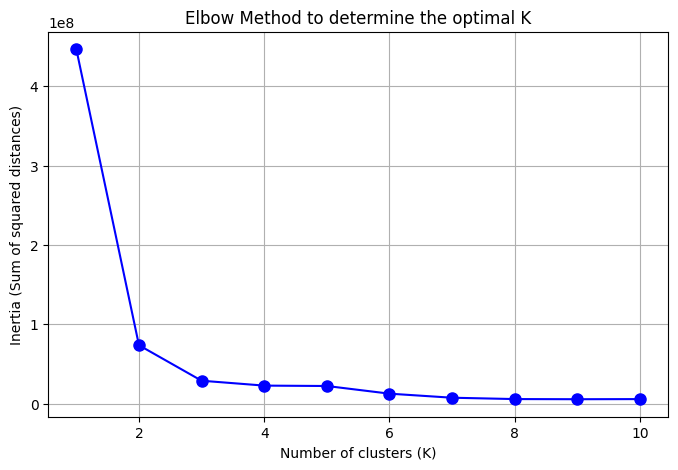

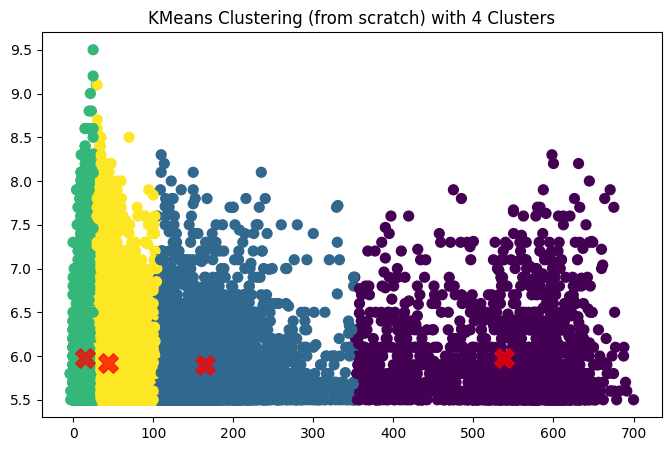

In [126]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

path_for_dataset = './.venv/Significant Earthquake Dataset 1900-2023 2.csv'
dataset = pd.read_csv(path_for_dataset)
print(dataset.to_string())
dataset.drop(columns=['Time',
                      'Place','Latitude','Longitude',
                      'MagType','nst','gap','dmin','rms','net','ID','Updated',
                      'Type','horizontalError','depthError','magError','magNst','status','locationSource','magSource',
                      'Unnamed: 14'],
                      axis=1,inplace=True)


# print(dataset.info())
dataset.dropna(inplace=True)
dataset.reset_index(drop=True, inplace=True)



# Step 2: KMeans functions

def initialize_centroids(X, k):
    """ Randomly initialize k centroids from the dataset X. """
    centroids = X.sample(n=k).values  # Randomly select k samples as initial centroids
    return centroids

def assign_clusters(X, centroids):
    """ Assign each point to the nearest centroid. """
    distances = np.sqrt(((X.values[:, np.newaxis] - centroids)**2).sum(axis=2))  # Calculate Euclidean distance
    return np.argmin(distances, axis=1)

def update_centroids(X, clusters, k):
    """ Update the centroids as the mean of points assigned to each cluster. """
    new_centroids = np.array([X[clusters == i].mean(axis=0) for i in range(k)])
    return new_centroids

def compute_inertia(X, centroids, clusters):
    """ Compute the inertia (sum of squared distances to the closest centroid). """
    distances = np.sqrt(((X.values - centroids[clusters])**2).sum(axis=1))
    return np.sum(distances**2)

def kmeans(X, k, max_iters=100):
    """ The KMeans algorithm implementation from scratch. """
    # Step 1: Initialize centroids
    centroids = initialize_centroids(X, k)
    
    for _ in range(max_iters):
        # Step 2: Assign clusters
        clusters = assign_clusters(X, centroids)
        
        # Step 3: Update centroids
        new_centroids = update_centroids(X, clusters, k)
        
        # If centroids don't change, stop the iteration
        if np.all(centroids == new_centroids):
            break
        centroids = new_centroids

    # Return the final cluster assignments and centroids
    return clusters, centroids

# Step 3: Elbow method to find optimal K
def elbow_method(X, max_k=10):
    """ Use the elbow method to find the optimal number of clusters. """
    inertia_values = []

    for k in range(1, max_k + 1):
        clusters, centroids = kmeans(X, k)
        inertia = compute_inertia(X, centroids, clusters)
        inertia_values.append(inertia)

    return inertia_values

# Step 4: Run the Elbow Method
inertia_values = elbow_method(dataset, max_k=10)

# Step 5: Plot the Elbow graph
plt.figure(figsize=(8, 5))
plt.plot(range(1, 11), inertia_values, 'bo-', markersize=8)
plt.xlabel('Number of clusters (K)')
plt.ylabel('Inertia (Sum of squared distances)')
plt.title('Elbow Method to determine the optimal K')
plt.grid(True)
plt.show()

# Step 6: Choose the optimal K (e.g., from the elbow plot, assume optimal_k is 4)
optimal_k = 4
clusters, centroids = kmeans(dataset, optimal_k)

# Step 7: Plot the resulting clusters
plt.figure(figsize=(8, 5))
plt.scatter(dataset['Depth'], dataset['Mag'], c=clusters, cmap='viridis', s=50)
plt.scatter(centroids[:, 0], centroids[:, 1], c='red', s=200, alpha=0.75, marker='X')  # Cluster centers
plt.title(f'KMeans Clustering (from scratch) with {optimal_k} Clusters')
plt.show()

#K means converges to find the local minimum not global minimum



In [116]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

path_for_dataset = './.venv/Significant Earthquake Dataset 1900-2023 2.csv'
dataset = pd.read_csv(path_for_dataset)
print(dataset.to_string())
dataset.drop(columns=['Time',
                      'Place','Latitude','Longitude',
                      'MagType','nst','gap','dmin','rms','net','ID','Updated',
                      'Type','horizontalError','depthError','magError','magNst','status','locationSource','magSource',
                      'Unnamed: 14'],
                      axis=1,inplace=True)

# Step 2: KMeans functions (from scratch)

def initialize_centroids(X, k):
    """ Randomly initialize k centroids from the dataset X. """
    return X.sample(n=k).values

def assign_clusters(X, centroids):
    """ Assign each point to the nearest centroid. """
    distances = np.sqrt(((X.values[:, np.newaxis] - centroids)**2).sum(axis=2))
    return np.argmin(distances, axis=1)

def update_centroids(X, clusters, k):
    """ Update centroids to be the mean of points in each cluster. """
    return np.array([X[clusters == i].mean(axis=0) for i in range(k)])

def compute_inertia(X, centroids, clusters):
    """ Compute inertia (sum of squared distances to the nearest centroid). """
    distances = np.sqrt(((X.values - centroids[clusters])**2).sum(axis=1))
    return np.sum(distances**2)

def kmeans(X, k, max_iters=100):
    """ KMeans algorithm from scratch. """
    centroids = initialize_centroids(X, k)
    
    for _ in range(max_iters):
        clusters = assign_clusters(X, centroids)
        new_centroids = update_centroids(X, clusters, k)
        if np.all(centroids == new_centroids):
            break
        centroids = new_centroids

    return clusters, centroids

# Step 3: Silhouette Score calculation (from scratch)

def silhouette_score(X, clusters, centroids):
    """ Calculate the silhouette score for each point. """
    n_samples = X.shape[0]
    silhouette_scores = np.zeros(n_samples)
    
    for i in range(n_samples):
        cluster_i = clusters[i]
        other_clusters = np.unique(clusters)
        
        # Cohesion (a): Average distance to other points in the same cluster
        in_cluster = X[clusters == cluster_i]
        a = np.mean(np.sqrt(((X.iloc[i] - in_cluster)**2).sum(axis=1)))  # Mean distance to points in the same cluster
        
        # Separation (b): Average distance to points in the nearest different cluster
        b = np.inf
        for cluster in other_clusters:
            if cluster != cluster_i:
                other_cluster_points = X[clusters == cluster]
                dist_to_other_cluster = np.mean(np.sqrt(((X.iloc[i] - other_cluster_points)**2).sum(axis=1)))
                b = min(b, dist_to_other_cluster)
        
        # Silhouette score for point i
        silhouette_scores[i] = (b - a) / max(a, b)
    
    return silhouette_scores

# Step 4: Using Silhouette Score to evaluate different K values
def evaluate_kmeans(X, max_k=10):
    silhouette_avg_scores = []

    for k in range(2, max_k + 1):  # Start with k=2 since silhouette requires at least 2 clusters
        clusters, centroids = kmeans(X, k)
        scores = silhouette_score(X, clusters, centroids)
        silhouette_avg_scores.append(np.mean(scores))

    return silhouette_avg_scores

# Step 5: Evaluate KMeans with different cluster numbers using silhouette scores
silhouette_avg_scores = evaluate_kmeans(dataset, max_k=10)

# Step 6: Plot Silhouette scores for different K values
plt.figure(figsize=(8, 5))
plt.plot(range(2, 11), silhouette_avg_scores, 'bo-', markersize=8)
plt.xlabel('Number of clusters (K)')
plt.ylabel('Average Silhouette Score')
plt.title('Silhouette Score for different K values')
plt.grid(True)
plt.show()

# Step 7: Choose the optimal K (e.g., from silhouette plot, assume optimal_k is 4)
optimal_k = 4
clusters, centroids = kmeans(dataset, optimal_k)

# Step 8: Plot the resulting clusters
plt.figure(figsize=(8, 5))
plt.scatter(dataset['Depth'], dataset['Mag'], c=clusters, cmap='viridis', s=50)
plt.scatter(centroids[:, 0], centroids[:, 1], c='red', s=200, alpha=0.75, marker='X')  # Cluster centers
plt.title(f'KMeans Clustering (from scratch) with {optimal_k} Clusters')
plt.show()


KeyboardInterrupt: 

         Depth   Mag        gap
0       38.615  6.10   51.00000
1       36.029  5.60   26.00000
2       20.088  6.10   47.00000
3       74.320  5.70   40.00000
4       10.000  5.60   28.00000
5      374.033  6.10  178.00000
6       10.000  5.60   84.00000
7       48.780  5.90   37.00000
8       10.000  5.50   50.00000
9       35.000  5.50   31.00000
10      10.000  5.50   28.00000
11      10.000  5.50   45.00000
12      57.855  5.50   83.00000
13      10.000  6.00   29.00000
14      12.336  5.70   69.00000
15      10.000  5.80   67.00000
16      20.094  6.00   63.00000
17      10.000  7.50   17.00000
18      10.000  5.50   45.00000
19      10.000  5.60   47.00000
20      10.708  6.70   19.00000
21      10.000  5.70   75.00000
22      17.943  7.80   17.00000
23      68.019  5.50  100.00000
24      10.000  5.80   72.00000
25     111.785  5.90   19.00000
26      19.000  6.00   35.00000
27      28.000  5.70   21.00000
28      16.000  5.90   31.00000
29     131.000  6.00   34.00000
30      

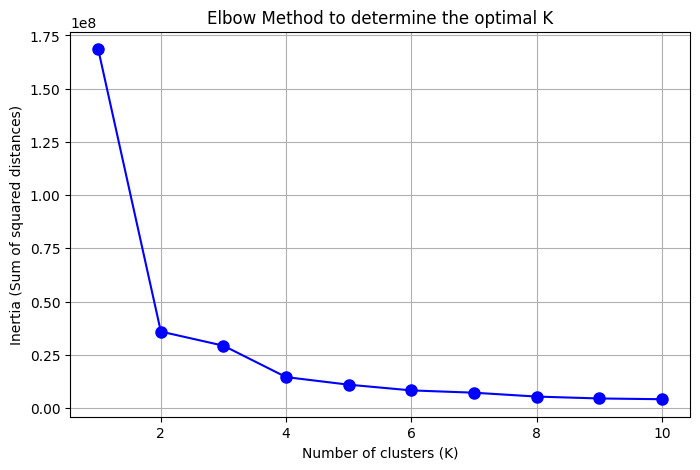

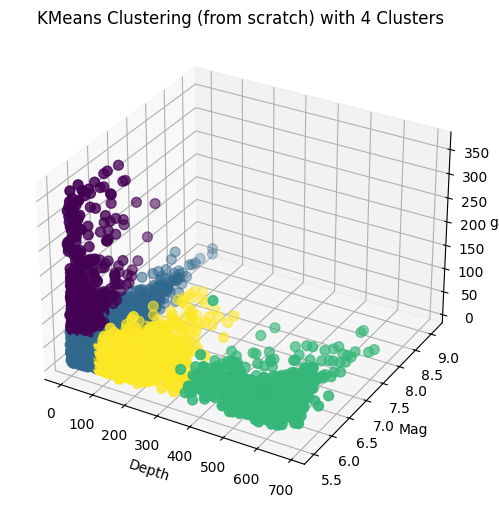

In [123]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D



path_for_dataset = './.venv/Significant Earthquake Dataset 1900-2023 2.csv'
dataset = pd.read_csv(path_for_dataset)

dataset.drop(columns=['Time',
                      'Place','Latitude','Longitude',
                      'MagType','nst','dmin','rms','net','ID','Updated',
                      'Type','horizontalError','depthError','magError','magNst','status','locationSource','magSource',
                      'Unnamed: 14'],
                      axis=1,inplace=True)



# print(dataset.info())
dataset.dropna(inplace=True)
dataset.reset_index(drop=True, inplace=True)

# Step 2: KMeans functions (from scratch)

def initialize_centroids(X, k):
    """ Randomly initialize k centroids from the dataset X. """
    return X.sample(n=k).values

def assign_clusters(X, centroids):
    """ Assign each point to the nearest centroid. """
    distances = np.sqrt(((X.values[:, np.newaxis] - centroids)**2).sum(axis=2))  # Euclidean distance in 3D
    return np.argmin(distances, axis=1)

def update_centroids(X, clusters, k):
    """ Update centroids to be the mean of points in each cluster. """
    return np.array([X[clusters == i].mean(axis=0) for i in range(k)])

def compute_inertia(X, centroids, clusters):
    """ Compute inertia (sum of squared distances to the nearest centroid). """
    distances = np.sqrt(((X.values - centroids[clusters])**2).sum(axis=1))
    return np.sum(distances**2)

def kmeans(X, k, max_iters=100):
    """ KMeans algorithm from scratch. """
    # Initialize centroids
    centroids = initialize_centroids(X, k)
    
    for _ in range(max_iters):
        # Assign clusters
        clusters = assign_clusters(X, centroids)
        # Update centroids
        new_centroids = update_centroids(X, clusters, k)
        # If centroids don't change, stop the iteration
        if np.all(centroids == new_centroids):
            break
        centroids = new_centroids

    return clusters, centroids

# Step 3: Elbow Method to find optimal K
def elbow_method(X, max_k=10):
    """ Use the elbow method to find the optimal number of clusters. """
    inertia_values = []

    for k in range(1, max_k + 1):
        clusters, centroids = kmeans(X, k)
        inertia = compute_inertia(X, centroids, clusters)
        inertia_values.append(inertia)

    return inertia_values

# Step 4: Run the Elbow Method
inertia_values = elbow_method(dataset, max_k=10)

# Step 5: Plot the Elbow graph
plt.figure(figsize=(8, 5))
plt.plot(range(1, 11), inertia_values, 'bo-', markersize=8)
plt.xlabel('Number of clusters (K)')
plt.ylabel('Inertia (Sum of squared distances)')
plt.title('Elbow Method to determine the optimal K')
plt.grid(True)
plt.show()

# Step 6: Choose the optimal K (e.g., from the elbow plot, assume optimal_k is 4)
optimal_k = 4
clusters, centroids = kmeans(dataset, optimal_k)

# Step 7: Plot the resulting clusters in 3D
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')

# Plot the clusters
ax.scatter(dataset['Depth'], dataset['Mag'], dataset['gap'], c=clusters, cmap='viridis', s=50)

# Plot the centroids
ax.scatter(centroids[:, 0], centroids[:, 1], centroids[:, 2], c='red', s=200, alpha=0.75, marker='X')  # Cluster centers

ax.set_xlabel('Depth')
ax.set_ylabel('Mag')
ax.set_zlabel('gap')
plt.title(f'KMeans Clustering (from scratch) with {optimal_k} Clusters')
plt.show()

In [124]:

import numpy as np
import pandas as pd
from sklearn.datasets import make_blobs
from sklearn.metrics import pairwise_distances
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt


path_for_dataset = './.venv/Significant Earthquake Dataset 1900-2023 2.csv'
dataset = pd.read_csv(path_for_dataset)
print(dataset.to_string())
dataset.drop(columns=['Time',
                      'Place','Latitude','Longitude', 'gap',
                      'MagType','nst','dmin','rms','net','ID','Updated',
                      'Type','horizontalError','depthError','magError','magNst','status','locationSource','magSource',
                      'Unnamed: 14'],
                      axis=1,inplace=True)

dataset.dropna(inplace=True)
dataset.reset_index(drop=True, inplace=True)
print(dataset.to_string())

def spectral_clustering(X, n_clusters, n_neighbors=10):
    # Step 1: Compute the similarity matrix
    distance_matrix = pairwise_distances(X)
    similarity_matrix = np.exp(-distance_matrix ** 2 / (2. * np.std(distance_matrix) ** 2))
    
    # Step 2: Create the adjacency matrix
    adjacency_matrix = np.zeros(similarity_matrix.shape)
    for i in range(similarity_matrix.shape[0]):
        indices = np.argsort(similarity_matrix[i])[-n_neighbors-1:-1]  # n_neighbors closest points
        adjacency_matrix[i, indices] = similarity_matrix[i, indices]
        adjacency_matrix[indices, i] = similarity_matrix[i, indices]  # Make it symmetric

    # Step 3: Create the degree matrix
    degree_matrix = np.diag(adjacency_matrix.sum(axis=1))

    # Step 4: Compute the Laplacian matrix
    laplacian_matrix = degree_matrix - adjacency_matrix

    # Step 5: Compute the eigenvalues and eigenvectors
    eigenvalues, eigenvectors = np.linalg.eig(laplacian_matrix)
    
    # Step 6: Sort the eigenvalues and eigenvectors
    sorted_indices = np.argsort(eigenvalues)
    sorted_eigenvectors = eigenvectors[:, sorted_indices]
    
    # Step 7: Select the first k eigenvectors
    embedding = sorted_eigenvectors[:, :n_clusters]

    # Step 8: Normalize the embedding
    embedding_normalized = embedding / np.linalg.norm(embedding, axis=1)[:, np.newaxis]

    # Step 9: Perform KMeans clustering on the embedding
    kmeans = KMeans(n_clusters=n_clusters)
    labels = kmeans.fit_predict(embedding_normalized)

    return labels


n_clusters = 4  # Number of clusters
labels = spectral_clustering(dataset.values, n_clusters)

# Add the cluster labels to the DataFrame
dataset['Cluster'] = labels

plt.figure(figsize=(10, 6))
plt.scatter(dataset['Depth'], dataset['Mag'], c=dataset['Cluster'], cmap='viridis')
plt.title('Spectral Clustering Results')
plt.xlabel('Depth')
plt.ylabel('magnitude')
plt.colorbar(label='Cluster')
plt.show()



                           Time                                                                Place   Latitude   Longitude    Depth   Mag MagType    nst        gap       dmin      rms        net                            ID                   Updated  Unnamed: 14               Type  horizontalError  depthError  magError  magNst     status locationSource  magSource
0      2023-02-17T09:37:34.868Z                                         130 km SW of Tual, Indonesia  -6.598600  132.076300   38.615  6.10     mww  119.0   51.00000   2.988000   0.7600         us                    us6000jpl7  2023-02-17T17:58:24.040Z          NaN         earthquake            6.410       5.595  0.065000    23.0   reviewed             us         us
1      2023-02-16T05:37:05.138Z                                        7 km SW of Port-Olry, Vanuatu -15.091200  167.029400   36.029  5.60     mww   81.0   26.00000   0.392000   0.9400         us                    us6000jpb1  2023-02-17T05:41:32.448Z          NaN

KeyboardInterrupt: 

In [125]:
import pandas as pd
import numpy as np
from collections import defaultdict
import numpy as np
import pandas as pd
from sklearn.datasets import make_blobs
from sklearn.metrics import pairwise_distances
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt


path_for_dataset = './.venv/Significant Earthquake Dataset 1900-2023 2.csv'
dataset = pd.read_csv(path_for_dataset)
print(dataset.to_string())
dataset.drop(columns=['Time',
                      'Place','Latitude','Longitude', 'gap',
                      'MagType','nst','dmin','rms','net','ID','Updated',
                      'Type','horizontalError','depthError','magError','magNst','status','locationSource','magSource',
                      'Unnamed: 14'],
                      axis=1,inplace=True)
class DBSCAN:
    def __init__(self, eps=0.5, min_samples=5):
        self.eps = eps  # Maximum distance between two samples for them to be considered as in the same neighborhood
        self.min_samples = min_samples  # Minimum number of samples in a neighborhood for a point to be a core point
        self.labels_ = None  # To store the cluster labels

    def fit(self, X):
        """Fit the model using the provided DataFrame."""
        self.labels_ = np.full(X.shape[0], -1)  # Initialize all labels to -1 (indicating noise)
        cluster_id = 0
        
        for point_idx in range(X.shape[0]):
            if self.labels_[point_idx] != -1:  # If already labeled, skip
                continue
            
            # Find neighbors
            neighbors = self._region_query(X, point_idx)
            if len(neighbors) < self.min_samples:  # Not enough neighbors
                self.labels_[point_idx] = -1  # Mark as noise
            else:
                self._expand_cluster(X, point_idx, neighbors, cluster_id)
                cluster_id += 1  # Increment cluster ID

    def _region_query(self, X, point_idx):
        """Find neighbors within eps distance of the given point."""
        neighbors = []
        for idx in range(X.shape[0]):
            if np.linalg.norm(X.iloc[point_idx] - X.iloc[idx]) < self.eps:
                neighbors.append(idx)
        return neighbors

    def _expand_cluster(self, X, point_idx, neighbors, cluster_id):
        """Expand the cluster with the given point and its neighbors."""
        self.labels_[point_idx] = cluster_id  # Label the initial point
        i = 0
        
        while i < len(neighbors):
            neighbor_idx = neighbors[i]
            if self.labels_[neighbor_idx] == -1:  # Previously marked as noise
                self.labels_[neighbor_idx] = cluster_id  # Change to the current cluster
            elif self.labels_[neighbor_idx] == -1:  # Already assigned to a cluster
                i += 1
                continue
            
            self.labels_[neighbor_idx] = cluster_id  # Assign the cluster
            
            # Find new neighbors
            new_neighbors = self._region_query(X, neighbor_idx)
            if len(new_neighbors) >= self.min_samples:  # Only expand if sufficient neighbors
                neighbors += new_neighbors  # Append new neighbors
            
            i += 1

# Example usage
if __name__ == "__main__":
    # Create a sample DataFrame
    
    df = dataset

    # Fit DBSCAN model
    dbscan = DBSCAN(eps=3, min_samples=2)
    dbscan.fit(df)

    # Print the cluster labels
    print("Cluster Labels:")
    print(dbscan.labels_)


                           Time                                                                Place   Latitude   Longitude    Depth   Mag MagType    nst        gap       dmin      rms        net                            ID                   Updated  Unnamed: 14               Type  horizontalError  depthError  magError  magNst     status locationSource  magSource
0      2023-02-17T09:37:34.868Z                                         130 km SW of Tual, Indonesia  -6.598600  132.076300   38.615  6.10     mww  119.0   51.00000   2.988000   0.7600         us                    us6000jpl7  2023-02-17T17:58:24.040Z          NaN         earthquake            6.410       5.595  0.065000    23.0   reviewed             us         us
1      2023-02-16T05:37:05.138Z                                        7 km SW of Port-Olry, Vanuatu -15.091200  167.029400   36.029  5.60     mww   81.0   26.00000   0.392000   0.9400         us                    us6000jpb1  2023-02-17T05:41:32.448Z          NaN

KeyboardInterrupt: 